In [1]:
#!pip install gym==0.17.2
#!pip install gym-super-mario-bros==7.3.0
#!pip install nes-py==8.1.8
#!pip install tf-agents==0.5.0
#!pip install tensorflow==2.2.0

#librerias necesarias
!sudo apt-get update
!sudo apt-get install -y xvfb ffmpeg freeglut3-dev
!pip install 'imageio==2.4.0'
!pip install pyvirtualdisplay
!pip install tf-agents[reverb]
!pip install pyglet
!pip install swig
!pip install gym[atari,box2d,accept-rom-license]  #install gym and virtual display
!pip install gym-super-mario-bros

Get:1 https://packages.cloud.google.com/apt gcsfuse-focal InRelease [1227 B]
Get:2 https://packages.cloud.google.com/apt cloud-sdk InRelease [1618 B]
Get:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1581 B]
Hit:4 https://packages.cloud.google.com/apt google-fast-socket InRelease
Get:5 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Hit:6 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:7 https://packages.cloud.google.com/apt gcsfuse-focal/main amd64 Packages [27.8 kB]
Get:8 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:9 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [1027 kB]
Get:10 https://packages.cloud.google.com/apt cloud-sdk/main all Packages [1540 kB]
Get:11 https://packages.cloud.google.com/apt cloud-sdk/main amd64 Packages [3303 kB]
Get:12 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:13 http://security.ubuntu.com/ubuntu ja

In [2]:
from __future__ import absolute_import, division, print_function

import base64
import imageio
import IPython
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import PIL.Image
import pyvirtualdisplay
import reverb

import tensorflow as tf

from tf_agents.environments import suite_gym, tf_py_environment
from tf_agents.environments.wrappers import ActionRepeat
from tf_agents.networks.q_network import QNetwork
from tf_agents.agents.dqn.dqn_agent import DqnAgent
from tf_agents.utils import common
from tf_agents.replay_buffers import TFUniformReplayBuffer
from tf_agents.trajectories import trajectory
from tf_agents.policies import random_tf_policy
from tf_agents.drivers.dynamic_step_driver import DynamicStepDriver


from tf_agents.environments import gym_wrapper
from tf_agents.environments import tf_py_environment

import gym
from nes_py.wrappers import JoypadSpace
import gym_super_mario_bros
from gym_super_mario_bros.actions import SIMPLE_MOVEMENT

# To get smooth animations
import matplotlib.animation as animation
matplotlib.rc('animation', html='jshtml')

2024-10-06 13:44:18.108128: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-06 13:44:18.108184: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-06 13:44:18.109703: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


/opt/conda/lib/python3.10/site-packages/gym/envs/registration.py:505: UserWarning: WARN: The environment SuperMarioBros-v1 is out of date. You should consider upgrading to version `v3` with the environment ID `SuperMarioBros-v3`.
  logger.warn(


['NOOP', 'right', 'right A', 'right B', 'right A B', 'A', 'left']


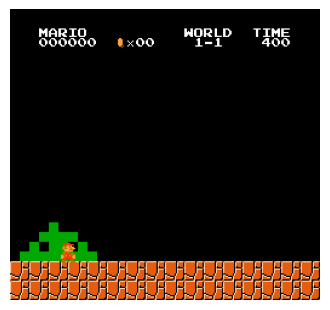

In [3]:
env = gym_super_mario_bros.make('SuperMarioBros-v1')
env = JoypadSpace(env, SIMPLE_MOVEMENT)
print(env.get_action_meanings())
state = env.reset()
env.step(env._action_space.sample())
img = env.render(mode="rgb_array")
plt.figure(figsize=(4, 6))
plt.imshow(img)
plt.axis("off")
plt.show()

In [4]:
# Crear el entorno
def create_environment():
    import gym
    from nes_py.wrappers import JoypadSpace
    import gym_super_mario_bros
    from gym_super_mario_bros.actions import SIMPLE_MOVEMENT
    env = gym_super_mario_bros.make('SuperMarioBros-v1')
    env = JoypadSpace(env, SIMPLE_MOVEMENT)
    env = gym_wrapper.GymWrapper(env)
    return env

eval_py_env = create_environment()
eval_env = tf_py_environment.TFPyEnvironment(eval_py_env)

# Crear una política aleatoria
random_policy = random_tf_policy.RandomTFPolicy(
    time_step_spec=eval_env.time_step_spec(),
    action_spec=eval_env.action_spec()
)

# Definir la función para ejecutar y visualizar la política aleatoria
def run_and_visualize_random(policy, env, max_steps=1000):
    frames = []
    time_step = env.reset()
    policy_state = policy.get_initial_state(env.batch_size)
    step_count = 0
    while not time_step.is_last() and step_count < max_steps:
        action_step = policy.action(time_step, policy_state)
        policy_state = action_step.state
        time_step = env.step(action_step.action)
        # Captura la observación actual
        frame = time_step.observation.numpy()[0]
        # Transforma la observación para visualizar
        frame = frame.astype(np.uint8)
        frames.append(frame)
        step_count += 1
    return frames

# Definir las funciones de animación
def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch

def plot_animation(frames, repeat=False, interval=40):
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim

# Ejecutar la política aleatoria y visualizar el juego
frames = run_and_visualize_random(random_policy, eval_env, max_steps=1000)
anim = plot_animation(frames)

from IPython.display import HTML
HTML(anim.to_jshtml())

In [5]:
# Create and wrap the environment
def create_environment():
    # Load the Super Mario Bros environment
    env = gym_super_mario_bros.make('SuperMarioBros-v1')
    # Simplify the action space
    env = JoypadSpace(env, SIMPLE_MOVEMENT)
    # Apply preprocessing wrappers
    #env = gym.wrappers.GrayScaleObservation(env, keep_dim=True)
    #env = gym.wrappers.ResizeObservation(env, 84)
    #env = gym.wrappers.FrameStack(env, 4)
    env = gym_wrapper.GymWrapper(env)
    return env

In [6]:
# Instantiate training and evaluation environments
train_py_env = create_environment()
eval_py_env = create_environment()

/opt/conda/lib/python3.10/site-packages/gym/envs/registration.py:505: UserWarning: WARN: The environment SuperMarioBros-v1 is out of date. You should consider upgrading to version `v3` with the environment ID `SuperMarioBros-v3`.
  logger.warn(


In [7]:
# Convert to TensorFlow Agents environments
train_env = tf_py_environment.TFPyEnvironment(train_py_env)
eval_env = tf_py_environment.TFPyEnvironment(eval_py_env)

In [8]:
# Define the Q-network
preprocessing_layer = tf.keras.layers.Lambda(lambda x: tf.cast(x, np.float32) / 255.)
conv_layer_params = [
    (128, (8, 8), 4),
    (256, (4, 4), 2),
    (128, (3, 3), 1),
]


'''
conv_layer_params = [
    (32, (8, 8), 4),
    (64, (4, 4), 2),
    (64, (3, 3), 1),
]
'''
fc_layer_params = [1024, 512]

q_net = QNetwork(
    input_tensor_spec=train_env.observation_spec(),
    action_spec=train_env.action_spec(),
    preprocessing_layers=preprocessing_layer,
    conv_layer_params=conv_layer_params,
    fc_layer_params=fc_layer_params
)

# Create the DQN agent
optimizer = tf.compat.v1.train.RMSPropOptimizer(
    learning_rate=4e-4, # 2.5e-4,
    decay=0.85, #0.95,
    momentum=0.2, #0.1,
    epsilon=0.03, #0.05,
    centered=True
)
train_step_counter = tf.Variable(0)

agent = DqnAgent(
    time_step_spec=train_env.time_step_spec(),
    action_spec=train_env.action_spec(),
    q_network=q_net,
    optimizer=optimizer,
    td_errors_loss_fn=common.element_wise_squared_loss,
    train_step_counter=train_step_counter,
    gamma=0.85, #0.99,
    epsilon_greedy=0.05,
    #epsilon_greedy = tf.keras.optimizers.schedules.PolynomialDecay(
    #initial_learning_rate=1.0,
    #decay_steps=50000,
    #end_learning_rate=0.01),
    target_update_period=300
)


In [9]:
agent.initialize()

# Create the replay buffer
replay_buffer = TFUniformReplayBuffer(
    data_spec=agent.collect_data_spec,
    batch_size=train_env.batch_size,
    max_length=10000
)

In [10]:
# Function to collect experience
def collect_step(environment, policy, buffer):
    time_step = environment.current_time_step()
    action_step = policy.action(time_step)
    next_time_step = environment.step(action_step.action)
    traj = trajectory.from_transition(time_step, action_step, next_time_step)
    buffer.add_batch(traj)

# Collect initial data with a random policy
random_policy = random_tf_policy.RandomTFPolicy(train_env.time_step_spec(), train_env.action_spec())
initial_collect_steps = 10000
for _ in range(initial_collect_steps):
    collect_step(train_env, random_policy, replay_buffer)

# Prepare the dataset
dataset = replay_buffer.as_dataset(
    num_parallel_calls=3,
    sample_batch_size=32,
    num_steps=2
).prefetch(3)
iterator = iter(dataset)

In [11]:
# Training the agent
num_iterations = 200000  # Adjust this value based on Kaggle's computational limits
collect_steps_per_iteration = 1
log_interval = 1000

for iteration in range(num_iterations):
    # Collect experience
    for _ in range(collect_steps_per_iteration):
        collect_step(train_env, agent.collect_policy, replay_buffer)
    # Sample a batch of data and train the agent
    experience, _ = next(iterator)
    train_loss = agent.train(experience).loss
    if iteration % log_interval == 0:
        print(f'Iteration: {iteration}, Loss: {train_loss}')



Iteration: 0, Loss: 0.07533024251461029
Iteration: 1000, Loss: 0.18249496817588806
Iteration: 2000, Loss: 0.9233471155166626
Iteration: 3000, Loss: 0.21572908759117126
Iteration: 4000, Loss: 5.035938739776611
Iteration: 5000, Loss: 0.3921967148780823
Iteration: 6000, Loss: 0.24803483486175537
Iteration: 7000, Loss: 0.36302274465560913
Iteration: 8000, Loss: 0.4685894250869751
Iteration: 9000, Loss: 0.44033917784690857
Iteration: 10000, Loss: 0.35033851861953735
Iteration: 11000, Loss: 0.42174094915390015
Iteration: 12000, Loss: 0.5919201374053955
Iteration: 13000, Loss: 0.2719222903251648
Iteration: 14000, Loss: 2.1234047412872314
Iteration: 15000, Loss: 0.2643434405326843
Iteration: 16000, Loss: 0.3107326626777649
Iteration: 17000, Loss: 0.7646282911300659
Iteration: 18000, Loss: 0.2619139552116394
Iteration: 19000, Loss: 0.20968317985534668
Iteration: 20000, Loss: 0.09149764478206635
Iteration: 21000, Loss: 0.2096892148256302
Iteration: 22000, Loss: 0.15308427810668945
Iteration: 230

In [12]:
# Evaluate the agent's performance
log_interval = 1000
num_eval_episodes = 5
for episode in range(num_eval_episodes):
    time_step = eval_env.reset()
    episode_reward = 0
    i = 0
    while not time_step.is_last():
        action_step = agent.policy.action(time_step)
        time_step = eval_env.step(action_step.action)
        episode_reward += time_step.reward
        i+=1
       
        if i % log_interval == 0:
            print(f'Episode {episode + 1}: Ite.: {i} :episode_reward : {episode_reward.numpy()[0]}')
    #print(f'Episode {episode + 1}: Reward = {episode_reward.numpy()[0]}')

Episode 1: Ite.: 1000 :episode_reward : 808.0
Episode 1: Ite.: 2000 :episode_reward : 758.0
Episode 1: Ite.: 3000 :episode_reward : 1846.0
Episode 2: Ite.: 1000 :episode_reward : 808.0
Episode 2: Ite.: 2000 :episode_reward : 758.0
Episode 2: Ite.: 3000 :episode_reward : 1846.0
Episode 3: Ite.: 1000 :episode_reward : 808.0
Episode 3: Ite.: 2000 :episode_reward : 758.0
Episode 3: Ite.: 3000 :episode_reward : 1846.0
Episode 4: Ite.: 1000 :episode_reward : 808.0
Episode 4: Ite.: 2000 :episode_reward : 758.0
Episode 4: Ite.: 3000 :episode_reward : 1846.0
Episode 5: Ite.: 1000 :episode_reward : 808.0
Episode 5: Ite.: 2000 :episode_reward : 758.0
Episode 5: Ite.: 3000 :episode_reward : 1846.0


In [13]:
# Crear el entorno
def create_environment():
    import gym
    from nes_py.wrappers import JoypadSpace
    import gym_super_mario_bros
    from gym_super_mario_bros.actions import SIMPLE_MOVEMENT
    env = gym_super_mario_bros.make('SuperMarioBros-v1')
    env = JoypadSpace(env, SIMPLE_MOVEMENT)
    env = gym_wrapper.GymWrapper(env)
    return env

eval_py_env = create_environment()
eval_env = tf_py_environment.TFPyEnvironment(eval_py_env)

# Definir la función para ejecutar y visualizar la política aleatoria
def run_and_visualize_random(agent, env, max_steps=1000):
    frames = []
    time_step = env.reset()
    policy_state = agent.policy.get_initial_state(env.batch_size)
    step_count = 0
    while not time_step.is_last() and step_count < max_steps:
        action_step = agent.policy.action(time_step, policy_state)
        policy_state = action_step.state
        time_step = env.step(action_step.action)
        # Captura la observación actual
        frame = time_step.observation.numpy()[0]
        # Transforma la observación para visualizar
        frame = frame.astype(np.uint8)
        frames.append(frame)
        step_count += 1
    return frames

# Definir las funciones de animación
def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch

def plot_animation(frames, repeat=False, interval=50):
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim

# Ejecutar la política aleatoria y visualizar el juego
frames = run_and_visualize_random(agent, eval_env, max_steps=10000)
anim = plot_animation(frames)

from IPython.display import HTML
HTML(anim.to_jshtml())

In [14]:
# Guardar la animación como un video MP4
def save_animation(anim, filename='mario_run.mp4', fps=25):
    anim.save(filename, writer='ffmpeg', fps=fps)
    print(f'Animación guardada como {filename}')
    
save_animation(anim, 'mario_run.mp4')

from IPython.display import FileLink
FileLink('mario_run.mp4')

Animación guardada como mario_run.mp4


/kaggle/working/mario_run.mp4